In [1]:
#Loading Relevant Libraries
install.packages("kknn")
library(kknn)
install.packages("themis")
library(themis)
library(tidyverse)
library(tidymodels)
library(repr)
library(RColorBrewer)
install.packages("GGally")
library(GGally)
library(ISLR)

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

also installing the dependencies ‘RANN’, ‘ROSE’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Loading required package: recipes

Loading required package: dplyr


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘recipes’


The following object is masked from ‘package:stats’:

    step


── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.2     ✔ purrr   1.0.1
✔ tibble  3.2.1     ✔ stringr 1.5.0
✔ tidyr   1.3.0     ✔ forcats 0.5.2
✔ readr   2.1.3     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter()  masks stats::filter()
✖ stringr::fixed() masks recipes::fixed()
✖ dplyr::lag()     masks stats::lag()
── Attachi

ERROR: Error in library(ISLR): there is no package called ‘ISLR’


In [8]:
set.seed(1000) 
#Reading in the Water Potability Dataset
url <- "https://raw.githubusercontent.com/chililw/dsci_group_project_027/main/water_potability.csv"
water_pot_data <- read_csv(url)

#Looking at the head of the data
head(water_pot_data)

Rows: 3276 Columns: 10
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
dbl (10): ph, Hardness, Solids, Chloramines, Sulfate, Conductivity, Organic_...

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
NA,204.8905,20791.32,7.300212,368.5164,564.3087,10.379783,86.99097,2.963135,0
3.716080,129.4229,18630.06,6.635246,NA,592.8854,15.180013,56.32908,4.500656,0
8.099124,224.2363,19909.54,9.275884,NA,418.6062,16.868637,66.42009,3.055934,0
8.316766,214.3734,22018.42,8.059332,356.8861,363.2665,18.436524,100.34167,4.628771,0
9.092223,181.1015,17978.99,6.546600,310.1357,398.4108,11.558279,31.99799,4.075075,0
5.584087,188.3133,28748.69,7.544869,326.6784,280.4679,8.399735,54.91786,2.559708,0


In [14]:
#Factor Recoding Potability
water_pot_cleaned <- water_pot_data |>
    mutate(Potability = as_factor(Potability)) |>
    mutate(Potability = fct_recode(Potability, "Potable" = "1", "Unpotable" = "0"))

#Dropping Missing Values from the Dataset
water_pot_cleaned <- water_pot_cleaned |>
    drop_na()

#Looking at the head of the factor recoded data
head(water_pot_cleaned)

ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
8.316766,214.3734,22018.42,8.059332,356.8861,363.2665,18.436524,100.34167,4.628771,Unpotable
9.092223,181.1015,17978.99,6.546600,310.1357,398.4108,11.558279,31.99799,4.075075,Unpotable
5.584087,188.3133,28748.69,7.544869,326.6784,280.4679,8.399735,54.91786,2.559708,Unpotable
10.223862,248.0717,28749.72,7.513408,393.6634,283.6516,13.789695,84.60356,2.672989,Unpotable
8.635849,203.3615,13672.09,4.563009,303.3098,474.6076,12.363817,62.79831,4.401425,Unpotable
11.180284,227.2315,25484.51,9.077200,404.0416,563.8855,17.927806,71.97660,4.370562,Unpotable


In [15]:
#Checking Counts of variables
water_pot_count <- water_pot_cleaned |>
    select(Potability) |>
    group_by(Potability) |>
    summarize(Count = n())
water_pot_count

Potability,Count
<fct>,<int>
Unpotable,1200
Potable,811


In [16]:
set.seed(1000) 
#Rebalancing the Data
ups_recipe <- recipe(Potability ~., data = water_pot_cleaned) |>
  step_upsample(Potability, over_ratio = 1, skip = FALSE) |>
  prep()

#Looking at the recipe specifications
ups_recipe

upsampled_water <- bake(ups_recipe, water_pot_cleaned)

Recipe

Inputs:

      role #variables
   outcome          1
 predictor          9

Training data contained 2011 data points and no missing data.

Operations:

Up-sampling based on Potability [trained]

In [19]:
#Looking at rebalanced count of potability classifications
upsampled_count <- upsampled_water |>
  group_by(Potability) |>
  summarize(n = n())

upsampled_count

Potability,n
<fct>,<int>
Unpotable,1200
Potable,1200


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


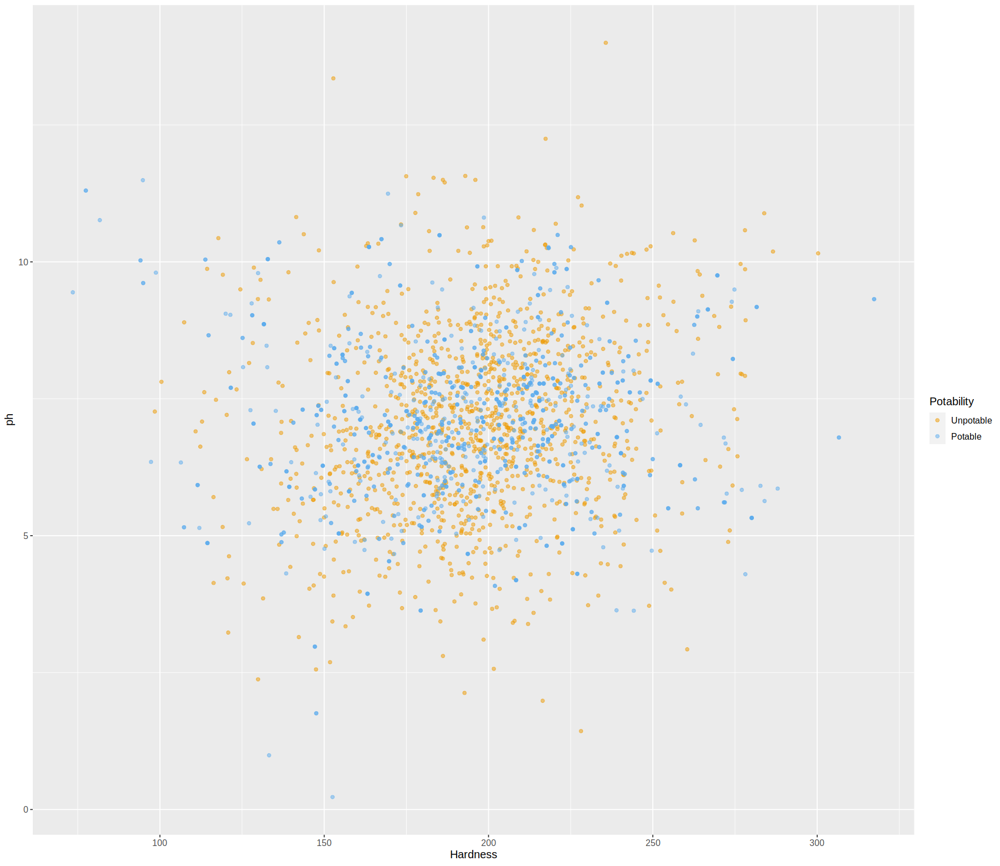

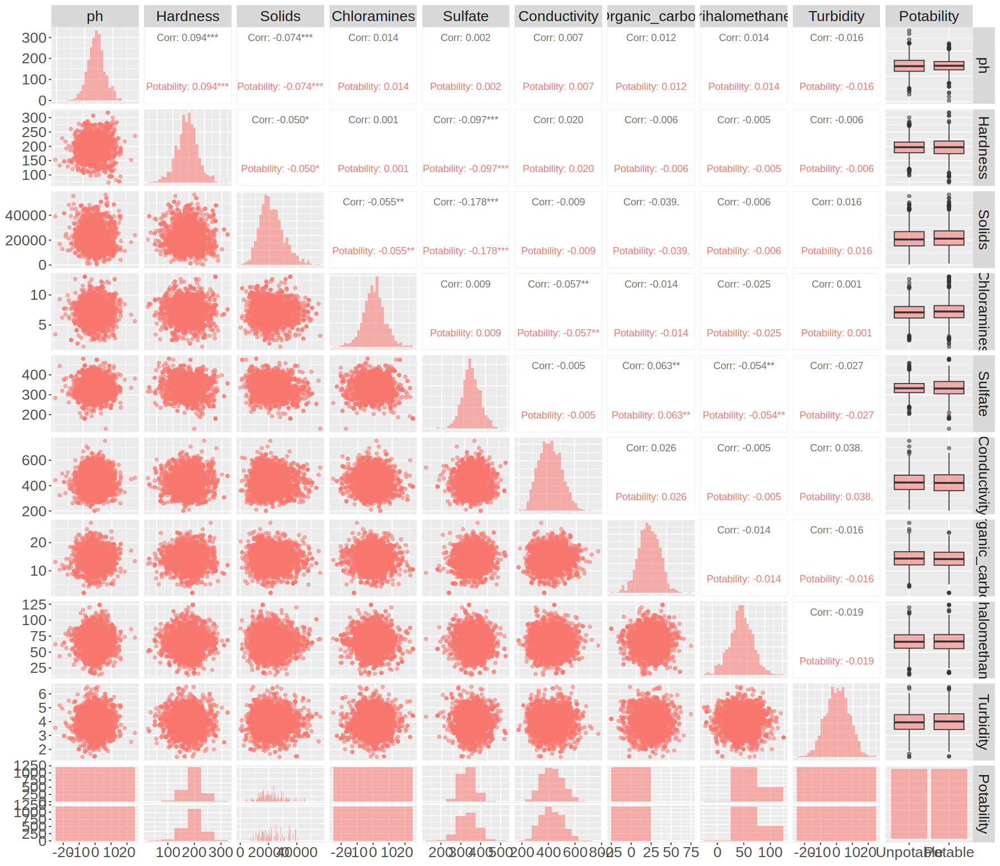

In [27]:
set.seed(1000) 
options(repr.plot.width = 15, repr.plot.height = 13)

#Visualizing two balanced predictor variables to illustrate synthetically generated data
water_pot_pred_plot <- upsampled_water |>
  ggplot(aes(x = Hardness, y = ph, color = Potability)) +
  geom_point(alpha = 0.5) +
  labs(color = "Potability") +
  scale_color_manual(values = c("orange2", "steelblue2")) + 
  theme(text = element_text(size = 12))

water_pot_pred_plot

#Using GGpairs to display the lack of correlation between potential predictor variables
water_pred_pairs <- upsampled_water |>
     ggpairs(
         lower=list(combo=wrap("facethist",  binwidth=50)),
         diag = list(continuous = "barDiag"),
         aes(color = "Potability", alpha = 0.4)
     ) +
     theme(text = element_text(size = 20)) 

water_pred_pairs
    

In [26]:
set.seed(1000) 

#Splitting the data into training and testing sets
water_split <- initial_split(upsampled_water, prop = 0.75, strata = Potability)
water_train <- training(water_split)
water_test <- testing(water_split)

In [10]:
set.seed(1000) 
names <- colnames(water_train |> select(-Potability))


# create an empty tibble to store the results
accuracies <- tibble(size = integer(), 
                     model_string = character(), 
                     accuracy = numeric())

# create a model specification
water_tune <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("classification")

# create a 5-fold cross-validation object
water_vfold <- vfold_cv(water_train, v = 5, strata = Potability)

# store the total number of predictors
n_total <- length(names)

# stores selected predictors
selected <- c()

# for every size from 1 to the total number of predictors
for (i in 1:n_total) {
    # for every predictor still not added yet
    accs <- list()
    models <- list()
    for (j in 1:length(names)) {
        # create a model string for this combination of predictors
        preds_new <- c(selected, names[[j]])
        model_string <- paste("Potability", "~", paste(preds_new, collapse="+"))

        # create a recipe from the model string
        water_recipe <- recipe(as.formula(model_string), 
                                data = water_train) |>
                          step_scale(all_predictors()) |>
                          step_center(all_predictors())

        # tune the KNN classifier with these predictors, 
        # and collect the accuracy for the best K
        acc <- workflow() |>
          add_recipe(water_recipe) |>
          add_model(water_tune) |>
          tune_grid(resamples = water_vfold, grid = 10) |>
          collect_metrics() |>
          filter(.metric == "accuracy") |>
          summarize(mx = max(mean))
        acc <- acc$mx |> unlist()

        # add this result to the dataframe
        accs[[j]] <- acc
        models[[j]] <- model_string
    }
    jstar <- which.max(unlist(accs))
    accuracies <- accuracies |> 
      add_row(size = i, 
              model_string = models[[jstar]], 
              accuracy = accs[[jstar]])
    selected <- c(selected, names[[jstar]])
    names <- names[-jstar]
}

accuracies

size,model_string,accuracy
<int>,<chr>,<dbl>
1,Potability ~ Chloramines,0.6965656
2,Potability ~ Chloramines+ph,0.7020151
3,Potability ~ Chloramines+ph+Sulfate,0.7441231
4,Potability ~ Chloramines+ph+Sulfate+Hardness,0.7643551
5,Potability ~ Chloramines+ph+Sulfate+Hardness+Solids,0.7643581
6,Potability ~ Chloramines+ph+Sulfate+Hardness+Solids+Organic_carbon,0.7632502
7,Potability ~ Chloramines+ph+Sulfate+Hardness+Solids+Organic_carbon+Conductivity,0.7572528
8,Potability ~ Chloramines+ph+Sulfate+Hardness+Solids+Organic_carbon+Conductivity+Turbidity,0.7403054
9,Potability ~ Chloramines+ph+Sulfate+Hardness+Solids+Organic_carbon+Conductivity+Turbidity+Trihalomethanes,0.7430496


In [12]:
set.seed(1000) 

#Setting tuning specifications and model recipe
water_tune <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("classification")

water_recipe <- recipe(Potability ~ Chloramines + ph + Sulfate + Hardness + Solids, data = water_train) |>
    step_scale(all_predictors()) |>
    step_center(all_predictors())

In [13]:
set.seed(1000) 
#K Neighbor Testing sequence
k_vals <- tibble(neighbors = seq(from = 1, to = 100, by = 2))

#Number of folds
water_vfold <- vfold_cv(water_train, v = 5, strata = Potability)

#Results
knn_results <- workflow() |>
    add_recipe(water_recipe) |>
    add_model(water_tune) |>
    tune_grid(resamples = water_vfold, grid = k_vals) |>
    collect_metrics()

knn_results

neighbors,.metric,.estimator,mean,n,std_err,.config
<dbl>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
1,accuracy,binary,0.7643581,5,0.009561929,Preprocessor1_Model01
1,roc_auc,binary,0.7636889,5,0.009580139,Preprocessor1_Model01
3,accuracy,binary,0.6987454,5,0.002077951,Preprocessor1_Model02
3,roc_auc,binary,0.7541546,5,0.004198544,Preprocessor1_Model02
5,accuracy,binary,0.6905622,5,0.011674628,Preprocessor1_Model03
5,roc_auc,binary,0.7525666,5,0.006106703,Preprocessor1_Model03
7,accuracy,binary,0.6883689,5,0.007340690,Preprocessor1_Model04
7,roc_auc,binary,0.7503093,5,0.009938676,Preprocessor1_Model04
9,accuracy,binary,0.6878209,5,0.008232460,Preprocessor1_Model05


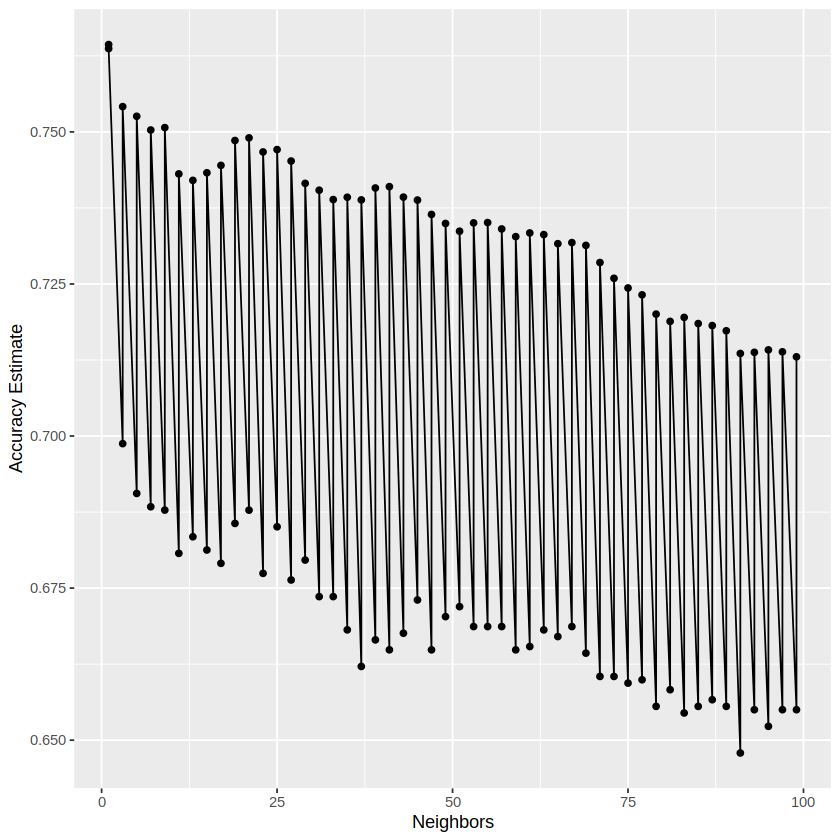

In [14]:
set.seed(1000) 

#Comparing number of neighbours to results
accuracies <- knn_results |>
    filter(.metric == "accuracy")

#Visualizing number of neighbours to accuracy
accuracy_versus_k <- ggplot(knn_results, aes(x = neighbors, y = mean))+
       geom_point() +
       geom_line() +
       labs(x = "Neighbors", y = "Accuracy Estimate") 
accuracy_versus_k

#K Selection is... 2?

In [15]:
set.seed(1000) 
#Determining the accuracy of the model given the chosen neighbors
water_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 2) |>
    set_engine("kknn") |>
    set_mode("classification")

knn_fit <- workflow() |>
       add_recipe(water_recipe) |>
       add_model(water_spec) |>
       fit(data = water_train) 

knn_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: nearest_neighbor()

── Preprocessor ────────────────────────────────────────────────────────────────
2 Recipe Steps

• step_scale()
• step_center()

── Model ───────────────────────────────────────────────────────────────────────

Call:
kknn::train.kknn(formula = ..y ~ ., data = data, ks = min_rows(2,     data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.267906
Best kernel: rectangular
Best k: 2

In [16]:
set.seed(1000) 
#Table of predictions
water_test_predictions <- predict(knn_fit, water_test) |>
  bind_cols(water_test)

water_test_predictions

.pred_class,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
Unpotable,9.092223,181.1015,17978.986,6.546600,310.1357,398.4108,11.558279,31.99799,4.075075,Unpotable
Unpotable,8.635849,203.3615,13672.092,4.563009,303.3098,474.6076,12.363817,62.79831,4.401425,Unpotable
Potable,6.660212,168.2837,30944.364,5.858769,310.9309,523.6713,17.884235,77.04232,3.749701,Unpotable
Potable,6.514415,198.7674,21218.703,8.670937,323.5963,413.2905,14.900000,79.84784,5.200885,Unpotable
Potable,10.682966,173.3755,15758.741,5.570784,307.3526,323.8079,10.090870,78.47278,3.999775,Unpotable
Potable,9.147197,211.7141,11920.611,7.230795,339.7519,527.7089,18.275312,47.63488,3.794532,Unpotable
Unpotable,10.560745,181.8934,21783.651,6.991260,340.3904,456.5564,16.482835,34.25205,3.964686,Unpotable
Potable,3.906078,233.4028,32144.800,6.994840,348.3594,269.4491,9.654126,63.74306,3.902880,Unpotable
Unpotable,6.217273,130.9445,19460.383,7.092463,300.1313,556.6537,14.083608,57.89707,5.325833,Unpotable


In [17]:
set.seed(1000) 
#Accuracy of the model
water_test_predictions |>
  metrics(truth = Potability, estimate = .pred_class) |>
  filter(.metric == "accuracy")

.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.7934426


In [18]:
set.seed(1000) 
#Confusion matrix of results
confusion <- water_test_predictions |>
             conf_mat(truth = Potability, estimate = .pred_class) 
confusion 

           Truth
Prediction  Unpotable Potable
  Unpotable       225      51
  Potable          75     259

In [20]:
set.seed(1000) 
#Accuracy, precision, and recall of classification model
accuracy <- tibble(accuracy =((225 + 259)/(225+51+75+259)))
precision <- tibble(precision = (225/(225 + 51)))
recall <- tibble(recall = (225/(225+75)))

accuracy
precision
recall

accuracy
<dbl>
0.7934426


precision
<dbl>
0.8152174


recall
<dbl>
0.75
